In [1]:
using Plots
using LaTeXStrings

using Statistics

# Global constants 

In [2]:
C_m = 9 * pi

E_Na = 115

E_K = -12

V_rest = 10.6

G_Na = 1080 * pi

G_K = 324 * pi

G_m = 2.7 * pi

8.482300164692441

# Empirical equations 

In [3]:
function alpha_n(V)
    
    return (10 - V) / (100 * (exp((10 - V) / 10) - 1))
    
end

function beta_n(V)
   
    return 0.125 * exp(-V / 80)
    
end

function alpha_m(V)
    
    return (25 - V) / (10 * (exp((25 - V) / 10) - 1))
    
end

function beta_m(V)
   
    return 4 * exp(-V / 18)
    
end

function alpha_h(V)
   
    return 0.07 * exp(-V / 20)
    
end

function beta_h(V)
   
    return 1 / (exp((30 - V) / 10) + 1)
    
end

beta_h (generic function with 1 method)

# Current input 

In [4]:
function I(t, I0)
   
    return I0
    
end

I (generic function with 1 method)

# Diferential equations 

In [5]:
function n_dot(n, V)
   
    return alpha_n(V) * (1 - n) - beta_n(V) * n
    
end

function m_dot(m, V)
   
    return alpha_m(V) * (1 - m) - beta_m(V) * m
    
end

function h_dot(h, V)
   
    return alpha_h(V) * (1 - h) - beta_h(V) * h
    
end

function V_dot(V, n, m, h, I0, t)
   
    return (G_Na * m^3 * h * (E_Na - V) + G_K * n^4 * (E_K - V) + G_m * (V_rest - V) + I(t, I0)) / C_m
    
end

V_dot (generic function with 1 method)

# RK-4 solver 

In [6]:
@inbounds function Hodgkin_Huxley(N, h_int, dt, I0, V0, n0, m0, h0)

    tf = Int(floor(N * dt))
    writting_period = Int(floor(dt / h_int))
    
    h_2 = 0.5 * h_int
    h_6 = h_int / 6
    
    data = zeros(5, N)
    
    data[1, 1] = 0
    data[2, 1] = V0
    data[3, 1] = n0
    data[4, 1] = m0
    data[5, 1] = h0
    
    V = V0
    n = n0
    m = m0
    h = h0
    
    k = 1
    i = 1
    
    t = 0
    
    while i < N
        
        for k in 1 : writting_period

            k_1n = n_dot(n, V)
            k_1m = m_dot(m, V)
            k_1h = h_dot(h, V)
            k_1V = V_dot(V, n, m, h, I0, t)

            k_2n = n_dot((n + h_2 * k_1n), (V + h_2 * k_1V))
            k_2m = m_dot((m + h_2 * k_1m), (V + h_2 * k_1V))
            k_2h = h_dot((h + h_2 * k_1h), (V + h_2 * k_1V))
            k_2V = V_dot((V + h_2 * k_1V), (n + h_2 * k_1n), (m + h_2 * k_1m), (h + h_2 * k_1h), I0, t)

            k_3n = n_dot((n + h_2 * k_2n), (V + h_2 * k_2V))
            k_3m = m_dot((m + h_2 * k_2m), (V + h_2 * k_2V))
            k_3h = h_dot((h + h_2 * k_2h), (V + h_2 * k_2V))
            k_3V = V_dot((V + h_2 * k_2V), (n + h_2 * k_2n), (m + h_2 * k_2m), (h + h_2 * k_2h), I0, t)

            k_4n = n_dot((n + h_int * k_3n), (V + h_int * k_3V))
            k_4m = m_dot((m + h_int * k_3m), (V + h_int * k_3V))
            k_4h = h_dot((h + h_int * k_3h), (V + h_int * k_3V))
            k_4V = V_dot((V + h_int * k_3V), (n + h_int * k_3n), (m + h_int * k_3m), (h + h_int * k_3h), I0, t)

            n += h_6 * (k_1n + 2 * k_2n + 2 * k_3n + k_4n)
            m += h_6 * (k_1m + 2 * k_2m + 2 * k_3m + k_4m)
            h += h_6 * (k_1h + 2 * k_2h + 2 * k_3h + k_4h)
            V += h_6 * (k_1V + 2 * k_2V + 2 * k_3V + k_4V)
            
            t += h_int
            
        end
            
        i += 1
        
        data[1, i]= t
        data[2, i] = V
        data[3, i] = n
        data[4, i] = m
        data[5, i] = h
        
    end
        
    return data
    
end

Hodgkin_Huxley (generic function with 1 method)

# Analysis functions 

In [7]:
function frequency(data, threshold)
   
    V = data[2, :]
    
    ts = []
    
    for i in 3 : length(V)
       
        if V[i-2] < V[i-1] && V[i] < V[i-1] && V[i-1] > threshold
            
            append!(ts, data[1, i-1])
            
        end
        
    end
    
    periods = (circshift(ts, -1) .- ts)[1 : end-1]
    
    if length(periods) == 0
        
        freq = 0
        err = 0
        
    elseif length(periods) == 1
        
        freq = 1 / mean(periods) * 1000 #Convert to Hz as period is in ms
        err = 0
        
    else
    
        freq = 1 / mean(periods) * 1000 #Convert to Hz as period is in ms
        err = 1000 * sqrt(var(periods) / length(periods)) / mean(periods)^2
        
    end
    
    return freq, err
    
end

@inbounds function freq_analysis(N, h_int, dt, V0, n0, m0, h0, Is, threshold, filename)
    
    freqs = zeros(length(Is))
    
    f = open(filename, "w")
    
    println(f, "#I\tF\tε")
    
    i = 0
   
    for I0 in Is
        
        i += 1
        
        result = Hodgkin_Huxley(N, h_int, dt, I0, V0, n0, m0, h0)
        
        freq = frequency(result, threshold)
        
        freqs[i] = freq[1]
        
        println(f, I0, "\t", freq[1], "\t", freq[2])
        
        #n, m and h inputs for the new simulation can be setted as the final ones of the current sim
        n = result[3, end]
        m = result[4, end]
        h = result[5, end]

    end
    
    close(f)
    
    return freqs
    
end

freq_analysis (generic function with 1 method)

# Run simulation 

In [27]:
N = 10 * 10^4

h_int = 0.001
dt = h_int

I0 = 180

V0 = 0
n0 = 0.5
m0 = 0.5
h0 = 0.5

result = Hodgkin_Huxley(N, h_int, dt, I0, V0, n0, m0, h0)

5×100000 Array{Float64,2}:
 0.0  0.001     0.002     0.003     …  99.997      99.998      99.999    
 0.0  0.836083  1.65484   2.45712      -4.44678    -4.44497    -4.44316  
 0.5  0.499968  0.499937  0.499909      0.429232    0.4292      0.429169 
 0.5  0.498165  0.496431  0.494792      0.0297216   0.0297281   0.0297346
 0.5  0.50001   0.500016  0.500019      0.423632    0.423669    0.423706 

# Compute $\nu$ vs $I_0$

In [9]:
Is = 350 : -1 : 150

threshold = 50

filename = "freq_350_150.txt"

#freqs = @time freq_analysis(N, h_int, dt, V0, n0, m0, h0, Is, threshold, filename);

# Potential in time $V(t)$

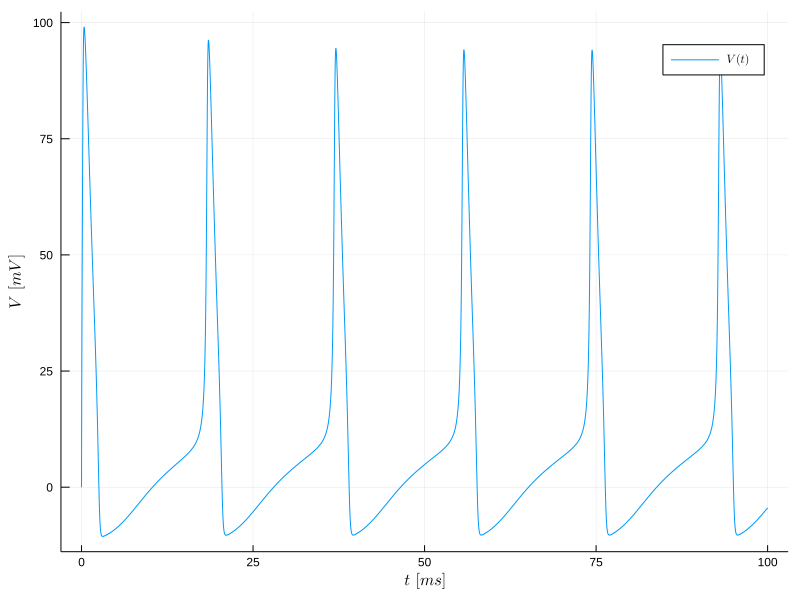

In [28]:
plot(result[1, :], result[2, :], label=L"$V(t)$", legend=:topright, size=(800, 600), 
    xlabel=L"$t \ [ms]$", ylabel=L"$V \ [mV]$")

#savefig("V_t_170.png")

# Evolution of $n(t)$ $m(t)$ and $h(t)$ 

In [11]:
plot(result[1, :], result[3, :], label=L"$n(t)$", legend=:topleft, size=(800, 600), legendfontsize=12)
plot!(result[1, :], result[4, :], label=L"$m(t)$")
plot!(result[1, :], result[5, :], label=L"$h(t)$")

# Evolution of $I_{Na}(t)$, $I_{K}(t)$ and $I_L(t)$ 

In [12]:
I_Na = @. G_Na * result[4, :]^3 * result[5, :] * (result[2, :] - E_Na) 
I_K = @. G_K * result[3, :]^4 * (result[2, :] - E_K);
I_L = @. G_m * (V_rest - result[2, :]);

In [13]:
plot(result[1, :], I_Na, label=L"$I_{Na}(t)$", legend=:topleft, legendfontsize=12, 
    xlabel=L"$t \ [ms]$", ylabel=L"$I \ [\mu A]$")

plot!(result[1, :], I_K, label=L"$I_{K}(t)$")
plot!(result[1, :], I_L, label=L"$I_{L}(t)$")